# Influence of sunshine on GDP per capita
## A seminal study on the economic driving factors

Filip Darmanovic (01527089)

This paper explores the hypothesis that dreary weather discourages people from going outside and in turn makes them more productive. Likewise, that beautiful weather outside distracts people from their work, which should reflect in a country's GDP per capita.

Put differently, the sun makes life beautiful even if you are broke.

In [4]:
import pandas
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd

First we load WorldBank's GDP per Capita [dataset](https://data.worldbank.org/indicator/NY.GDP.PCAP.CD?end=2019&start=1960&type=shaded&view=chart&year=2008)

In [5]:
gdp_raw = pandas.read_csv('./input_data/API_NY.GDP.PCAP.CD_DS2_en_csv_v2_2163510/API_NY.GDP.PCAP.CD_DS2_en_csv_v2_2163510.csv', skiprows=4)
gdp_raw.drop(['Unnamed: 65', 'Indicator Code', 'Indicator Name'], axis=1, inplace=True)
gdp_raw.set_index(['Country Name', 'Country Code'], inplace=True)
gdp_raw

,,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,...,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
Country Name,Country Code,,,,,,,,,,,,,,,,,,,,,
Aruba,ABW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,24985.993281,24713.698045,26189.435509,26647.938101,27980.880695,28281.350482,29007.693003,NaN,NaN,NaN
Afghanistan,AFG,59.773194,59.860874,58.458015,78.706388,82.095231,101.108305,137.594352,160.898589,129.108323,129.329713,...,591.162759,641.871479,637.165523,613.856689,578.466353,509.218661,519.884773,493.750418,507.103432,NaN
Angola,AGO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4615.468028,5100.095808,5254.882338,5408.410496,4166.979684,3506.072885,4095.812942,3289.646664,2790.726615,NaN
Albania,ALB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4437.142885,4247.629984,4413.060861,4578.631994,3952.801215,4124.055726,4531.020806,5284.380184,5353.244856,NaN
Andorra,AND,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,43335.328862,38686.461264,39538.766722,41303.929371,35762.523074,37474.665406,38962.880354,41793.055258,40886.391165,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Kosovo,XKX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3741.875052,3596.804655,3891.266363,4080.330717,3603.025501,3780.003689,4045.614209,4419.914327,4417.524062,NaN
"Yemen, Rep.",YEM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1374.621285,1446.536354,1607.152365,1673.146354,1602.037841,1138.682995,960.528534,824.117629,774.334490,NaN
South Africa,ZAF,443.009816,454.962013,473.011615,511.497253,548.995942,584.704072,621.220825,675.135312,711.225810,780.625919,...,8007.412846,7501.469984,6832.456891,6433.187277,5734.633629,5272.918425,6132.479841,6374.028196,6001.400814,NaN


We check if there are big holes in the reporting, so that we can use the mean for general comparison.

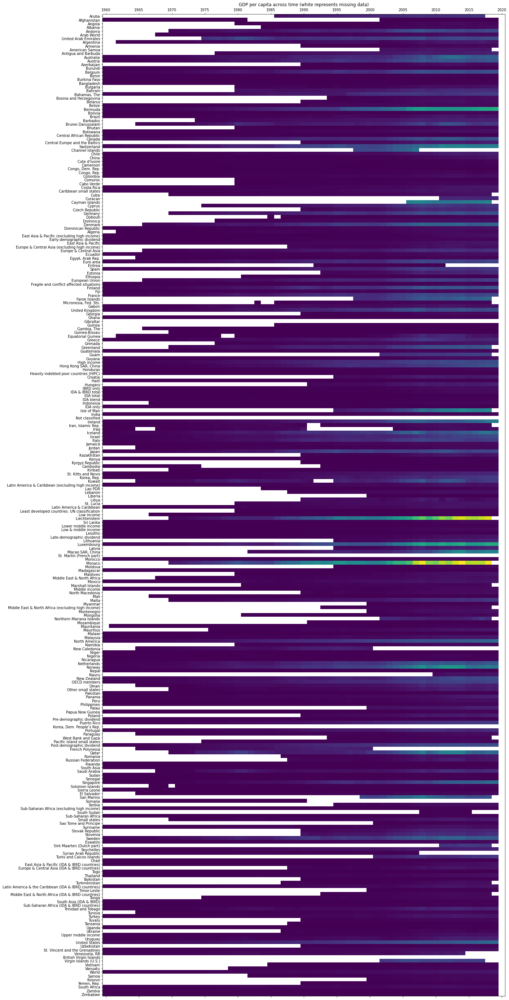

In [6]:
fig, ax = plt.subplots(1,1,figsize=(20,50))
ax.matshow(gdp_raw, aspect='auto')
ax.set_xticks(range(0, gdp_raw.shape[1], 5))
ax.set_yticks(range(gdp_raw.shape[0]))
ax.set_title('GDP per capita across time (white represents missing data)')
_ = ax.set_xticklabels(gdp_raw.columns[0::5])
_ = ax.set_yticklabels(gdp_raw.index.get_level_values(0))

In [7]:
gdp_melted = gdp_raw.melt(ignore_index=False,
    var_name='year', value_name='GDP per capita').dropna()
gdp_melted = gdp_melted.astype({'year':'int32'})
gdp_melted

,,year,GDP per capita
Country Name,Country Code,,
Afghanistan,AFG,1960,59.773194
Australia,AUS,1960,1807.785710
Austria,AUT,1960,935.460427
Burundi,BDI,1960,70.051735
Belgium,BEL,1960,1273.691659
...,...,...,...
Kosovo,XKX,2019,4417.524062
"Yemen, Rep.",YEM,2019,774.334490
South Africa,ZAF,2019,6001.400814


Since there are some holes in the data, we decide to introduce the min, max, and latest GDP per capita indicators in addition to the mean

In [8]:
#gdp_summarized = pandas.DataFrame(index=gdp_melted.index)
gdp_latest = gdp_melted[gdp_melted['year'] == gdp_melted.groupby(['Country Name'])['year'].transform(max)]
gdp_summarized = gdp_melted['GDP per capita'].groupby(['Country Name']).agg(['min', 'max', 'mean'])
gdp_summarized = gdp_summarized.join(gdp_latest)
gdp_summarized.rename(columns={'year': 'latest year', 'GDP per capita':'latest GDP'}, inplace=True)
gdp_summarized

,,min,max,mean,latest year,latest GDP
Country Name,Country Code,,,,,
Somalia,SOM,65.479597,188.661113,110.836099,1990,126.924921
New Caledonia,NCL,1756.219653,18721.056438,8807.545366,2000,12579.595106
French Polynesia,PYF,1889.323290,18261.826863,9525.111127,2000,14323.820820
Channel Islands,CHI,40585.382576,74462.646747,51427.189627,2007,74462.646747
Syrian Arab Republic,SYR,187.537374,2032.623489,935.394650,2007,2032.623489
...,...,...,...,...,...,...
Kosovo,XKX,1087.762401,4419.914327,3005.715279,2019,4417.524062
"Yemen, Rep.",YEM,285.569555,1673.146354,831.334504,2019,774.334490
South Africa,ZAF,443.009816,8007.412846,3164.325928,2019,6001.400814


In [9]:
sunshine_raw = pandas.read_excel('./input_data/Cities by Sunshine Duration.xlsx')
sunshine_raw

,Continent,Country,City,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Year
0,Africa,Ivory Coast,Gagnoa,183.0,180.0,196.0,188.0,181.0,118.0,97.0,80.0,110.0,155.0,171.0,164.0,1823.0
1,Africa,Ivory Coast,Bouaké,242.0,224.0,219.0,194.0,208.0,145.0,104.0,82.0,115.0,170.0,191.0,198.0,2092.0
2,Africa,Ivory Coast,Abidjan,223.0,223.0,239.0,214.0,205.0,128.0,137.0,125.0,139.0,215.0,224.0,224.0,2296.0
3,Africa,Ivory Coast,Odienné,242.0,220.2,217.3,214.7,248.8,221.8,183.5,174.5,185.4,235.8,252.0,242.6,2638.6
4,Africa,Ivory Coast,Ferké,279.0,249.0,253.0,229.0,251.0,221.0,183.0,151.0,173.0,245.0,261.0,262.0,2757.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
333,Oceania,New Zealand,Auckland,228.8,194.9,189.2,157.3,139.8,110.3,128.1,142.9,148.6,178.1,188.1,197.2,2003.1
334,Oceania,New Zealand,Christchurch,224.4,190.5,177.4,155.6,133.3,117.7,124.8,149.0,166.6,201.3,215.3,214.3,2070.2
335,Oceania,New Zealand,Wellington,240.3,205.0,194.7,153.8,126.0,102.3,111.4,137.2,163.2,191.1,210.8,222.9,2058.7
336,Oceania,Papua New Guinea,Port Moresby,182.0,158.0,184.0,200.0,211.0,200.0,203.0,222.0,213.0,231.0,243.0,216.0,2463.0


We load the [Cities by sunshine duration dataset](https://data.world/makeovermonday/2019w44), which is actually barely useful, as it contains data from at most a few cities from each country, and the source data sometimes doesn't even overlap. One redeeming quality is that this dataset does focus on the subjective feeling of cloudyness, which this study is aiming to explore.

In [10]:
sunshine_yearly_by_country = sunshine_raw.groupby(['Country']).mean()['Year']
sunshine_yearly_by_country.index.rename('Country Name', inplace=True)
sunshine_yearly_by_country.rename('Yearly sunshine hours',inplace=True)
sunshine_yearly_by_country.sort_values(ascending=False)

Country Name
Egypt                        3756.416667
Namibia                      3737.500000
Sudan                        3559.550000
United Arab Emirates         3508.700000
Oman                         3493.300000
                                ...     
United Kingdom               1530.000000
Ireland                      1453.000000
Saint Pierre and Miquelon    1427.300000
Iceland                      1326.000000
Faroe Islands                 840.000000
Name: Yearly sunshine hours, Length: 139, dtype: float64

In [11]:
gdp_sunshine = gdp_summarized.join(sunshine_yearly_by_country, how='inner')
gdp_sunshine

,,min,max,mean,latest year,latest GDP,Yearly sunshine hours
Country Name,Country Code,,,,,,
Somalia,SOM,65.479597,188.661113,110.836099,1990,126.924921,3103.000000
Eritrea,ERI,208.999947,642.507659,364.542339,2011,642.507659,3361.000000
South Sudan,SSD,1119.651333,1779.469334,1432.645916,2015,1119.651333,2841.300000
Faroe Islands,FRO,22653.316047,64269.704254,43374.404189,2018,64269.704254,840.000000
Afghanistan,AFG,58.458015,641.871479,282.966150,2019,507.103432,3175.100000
...,...,...,...,...,...,...,...
Uzbekistan,UZB,383.343068,2615.025134,1117.924210,2019,1724.841134,2823.900000
Vietnam,VNM,94.564731,2715.276036,901.952351,2019,2715.276036,2123.500000
South Africa,ZAF,443.009816,8007.412846,3164.325928,2019,6001.400814,3141.316667


A quick pearson correlation matrix shows that further exploration with a proper dataset and a more thorough research approach (regression) is worth pursuing. 

<ipython-input-12-adea15a72f02>:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(col_names, rotation=90)
<ipython-input-12-adea15a72f02>:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(col_names)


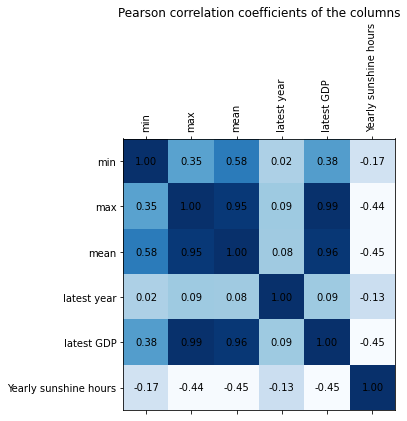

In [12]:
corr = gdp_sunshine.corr()
col_names = corr.columns.values

fig, ax = plt.subplots(figsize=(5,5))
ax.matshow(corr, cmap='Blues')
ax.set_xticklabels(col_names, rotation=90)
ax.set_yticklabels(col_names)
ax.set_yticks(range(len(col_names)))
ax.set_xticks(range(len(col_names)))
ax.set_title('Pearson correlation coefficients of the columns')
for (i, j), z in np.ndenumerate(corr):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center')



We load the borders of countries as geometric data from the [Admin 0 - Countries Dataset](http://www.naturalearthdata.com/downloads/10m-cultural-vectors/)

In [13]:
shapefile = './input_data/ne_10m_admin_0_countries/ne_10m_admin_0_countries.shp'
gdf = gpd.read_file(shapefile)[['ADMIN', 'ADM0_A3', 'geometry']]
gdf.columns = ['country', 'country_code', 'geometry']

gdf

,country,country_code,geometry
0,Indonesia,IDN,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4..."
1,Malaysia,MYS,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4..."
2,Chile,CHL,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611..."
3,Bolivia,BOL,"POLYGON ((-69.51009 -17.50659, -69.51009 -17.5..."
4,Peru,PER,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832..."
...,...,...,...
250,Macao S.A.R,MAC,"MULTIPOLYGON (((113.55860 22.16303, 113.56943 ..."
251,Ashmore and Cartier Islands,ATC,"POLYGON ((123.59702 -12.42832, 123.59775 -12.4..."
252,Bajo Nuevo Bank (Petrel Is.),BJN,"POLYGON ((-79.98929 15.79495, -79.98782 15.796..."
253,Serranilla Bank,SER,"POLYGON ((-78.63707 15.86209, -78.64041 15.864..."


In [34]:
gdp_sunshine_geo = gdf.merge(gdp_sunshine, how='left', left_on='country_code', right_on='Country Code')
gdp_sunshine_geo

,country,country_code,geometry,min,max,mean,latest year,latest GDP,Yearly sunshine hours
0,Indonesia,IDN,"MULTIPOLYGON (((117.70361 4.16341, 117.70361 4...",53.537298,4135.569263,1237.629522,2019.0,4135.569263,2983.300000
1,Malaysia,MYS,"MULTIPOLYGON (((117.70361 4.16341, 117.69711 4...",NaN,NaN,NaN,NaN,NaN,NaN
2,Chile,CHL,"MULTIPOLYGON (((-69.51009 -17.50659, -69.50611...",505.349201,15924.794239,5041.724370,2019.0,14896.453867,2648.540000
3,Bolivia,BOL,"POLYGON ((-69.51009 -17.50659, -69.51009 -17.5...",102.237890,3552.068760,1073.059158,2019.0,3552.068760,2288.900000
4,Peru,PER,"MULTIPOLYGON (((-69.51009 -17.50659, -69.63832...",253.264822,6977.695784,2209.009422,2019.0,6977.695784,2013.333333
...,...,...,...,...,...,...,...,...,...
250,Macao S.A.R,MAC,"MULTIPOLYGON (((113.55860 22.16303, 113.56943 ...",NaN,NaN,NaN,NaN,NaN,NaN
251,Ashmore and Cartier Islands,ATC,"POLYGON ((123.59702 -12.42832, 123.59775 -12.4...",NaN,NaN,NaN,NaN,NaN,NaN
252,Bajo Nuevo Bank (Petrel Is.),BJN,"POLYGON ((-79.98929 15.79495, -79.98782 15.796...",NaN,NaN,NaN,NaN,NaN,NaN
253,Serranilla Bank,SER,"POLYGON ((-78.63707 15.86209, -78.64041 15.864...",NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:title={'center':'Mean GDP per capita'}>

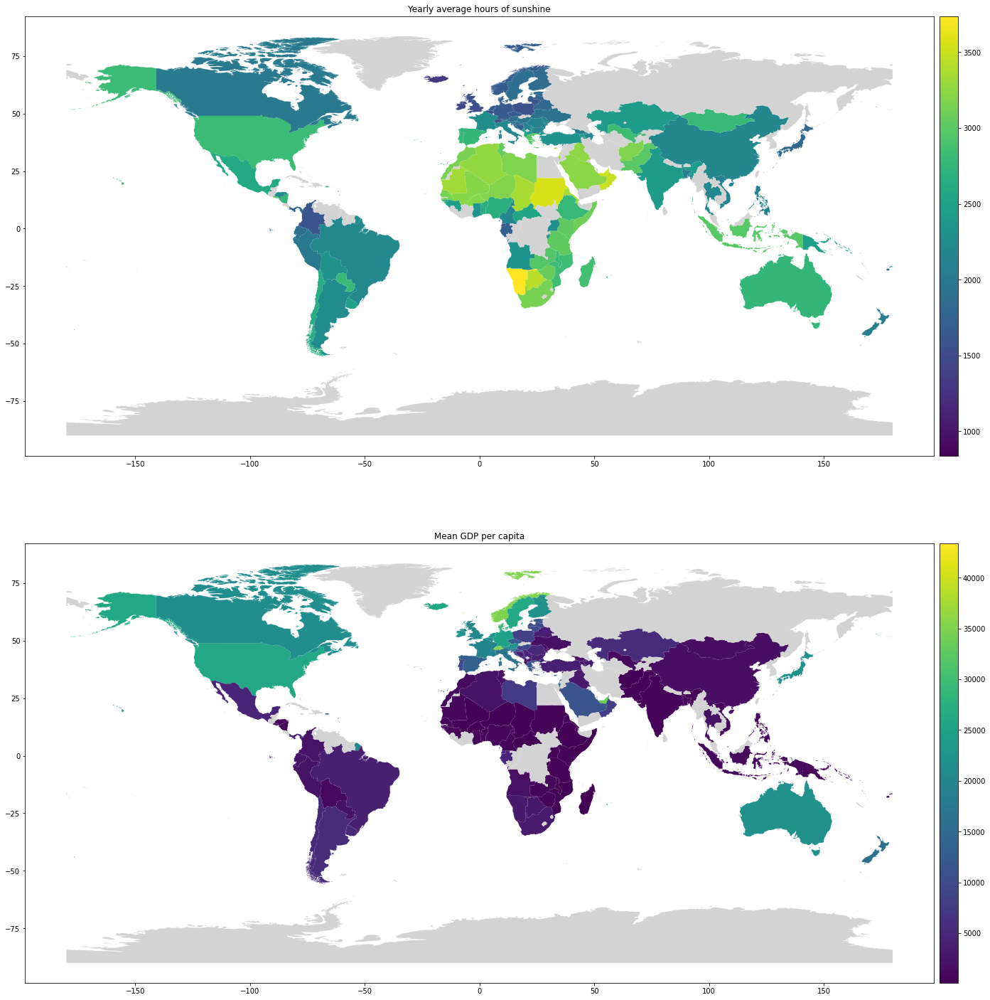

In [51]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(2, 1, figsize=(40, 25))
divider0 = make_axes_locatable(ax[0])
cax0 = divider0.append_axes('right', size='2%', pad=0.1)
divider1 = make_axes_locatable(ax[1])
cax1 = divider1.append_axes('right', size='2%', pad=0.1)
ax[0].set_title('Yearly average hours of sunshine')
ax[1].set_title('Mean GDP per capita')

gdp_sunshine_geo.plot(column='Yearly sunshine hours', ax=ax[0], cax=cax0, legend=True, missing_kwds={
         "color": "lightgrey",
         "label": "Missing values",
     })
gdp_sunshine_geo.plot(column='mean', ax=ax[1], cax=cax1, legend=True, missing_kwds={
         "color": "lightgrey",
         "label": "Missing values",
     })

Finally, we produce two artifacts: The output of our data-processing pipeline and the figure with two world map visualizations. 

In [54]:
fig.savefig('./output/sunshine_gdp_world.pdf', transparent=False)
gdp_sunshine.to_csv('./output/gdp_sunshine.csv')

## Conclusion
While we couldn't draw any scientifically significant conclusions regarding our hypothesis due to the scope of this study, we have shown that further exploration of this topic is an interesting research path